### This example illustrates tools that read in and parse OWI wind and pressure field data. Saves the data to a netcdf file.
### Additionally, this example shows how data can be interpolated in time and space given geoclaw defined patch dimensions and boundaries.

The module read_owi.py contains several functions for reading in OWI wind field data and parsing it to a usable format that contains the dimensions in lat/lon and time using xarray's Dataset class.

OWI wind/pressure field data contain the following format:
FIle header includes Oceanweather WIN/PRE Format and the dates of the storm, 
Ex: from synthetic storm data 

```Oceanweather WIN/PRE Format                            2000071212     2000071512```
Following the file header the format is header matrix header matrix etc... until the number of time steps is fulfilled:

```iLat= 105iLong=  97DX=0.2500DY=0.2500SWLat=22.00000SWLon=-82.0000DT=200007121200```

The matrix is formatted into rows of 8 numbers up to the total number of entries which is iLat * iLong. For the wind files data is provided first as velocity in x direction then y. Pressure contains only one set of matrices per time step.

read_owi.py uses regular expression matching to parse the header and matrix data correctly, stores the data in a dataclass then organizes it into an xarray.Dataet




In [1]:
%matplotlib inline
import numpy as np
import datetime
import xarray as xr
import re
import matplotlib.pyplot as plt
import cartopy
import cartopy.crs as ccrs
import read_OWI
import os
from clawpack.visclaw import animation_tools
from IPython.display import HTML

Place the path of the OWI wind and pressure files here

In [2]:
PATH = '/home/catherinej/storm_data/data/synthetic_owi_storms/Storm_0480'

### Reading and parsing the data
First OWI wind and pressure files typically come with more than 1 grid, one will be basin scale and one will be a more local option. To correctly pair the wind with the matching scale pressure file, create a list of files in the directory.

In [3]:
# Get list of files in the directory and split them by name and extension
filelist = [[fh, ext] for f, fh, ext in ((f, *os.path.splitext(f)) for f in os.listdir(PATH))]

# Obtain list of pressure files
pre_files = [f for f in filelist if f[1] == '.pre']

# obtain list of wind files
wind_files = [f for f in filelist if 'w' in f[1].lower()]

# Create empty list for pairs of wind and pressure files
storm_files = {}

# find the pairs of wind and pressure files put in a dict for processing
for f in wind_files:
    if f[0] in [row[0] for row in pre_files]:
        storm_files[f[0]] = {'pressure_file': f[0] + '.pre',
                             'wind_file': f[0] + f[1]}
print(storm_files)

{'NACCS_TP_0480_SYN_L2': {'pressure_file': 'NACCS_TP_0480_SYN_L2.pre', 'wind_file': 'NACCS_TP_0480_SYN_L2.WND'}, 'NACCS_TP_0480_SYN_L3': {'pressure_file': 'NACCS_TP_0480_SYN_L3.pre', 'wind_file': 'NACCS_TP_0480_SYN_L3.WND'}}


From this dictionary of files, we can see there are two of each, the files that match have the same prefix so are grouped together. For this set the L2 file is for the basin scale wind and pressure fields so we'll load this data

In [4]:
for name in storm_files:
    if 'L2' in name:
        wind_data = read_OWI.read_oceanweather(PATH, storm_files[name]['wind_file'])
        pressure_data = read_OWI.read_oceanweather(PATH, storm_files[name]['pressure_file'])

<class 'list'>
<class 'list'>


Now that the data is loaded into a dataclass we can format the data correctly. 
OWI provides the lower left corner for latitude and longitude (SWLat, SWLong) the resolution of the data (DX, DY) how many total datapoints in lat/lon (iLat, iLong) and the time steps for each matrix (DT). We need to create arrays with this data.
read_OWI.format_data takes the wind and pressure data, creates arrays of lat/lon, time, wind in x and y directions (uu & vv), pressure and the eye location (for basin scale only). 
Once all the data is organized into arrays its passed into an xarray.Dataset

In [5]:
ds = read_OWI.format_data(wind_data, pressure_data)
ds

<xarray.Dataset>
Dimensions:   (time: 865, lat: 105, lon: 97, x: 2)
Coordinates:
  * lat       (lat) float64 22.0 22.25 22.5 22.75 23.0 ... 47.25 47.5 47.75 48.0
  * lon       (lon) float64 -82.0 -81.75 -81.5 -81.25 ... -58.5 -58.25 -58.0
  * time      (time) datetime64[ns] 2000-07-12T12:00:00 ... 2000-07-15T12:00:00
Dimensions without coordinates: x
Data variables:
    u         (time, lat, lon) float64 0.0 0.0 0.0 0.0 ... -2.512 -2.525 -2.537
    v         (time, lat, lon) float64 0.0 0.0 0.0 0.0 ... 9.389 9.305 9.222
    speed     (time, lat, lon) float64 0.0 0.0 0.0 0.0 ... 9.719 9.642 9.564
    pressure  (time, lat, lon) float64 1.013e+03 1.013e+03 ... 1.008e+03
    eye_loc   (time, x) float64 -82.0 22.0 -82.0 22.0 ... -58.0 48.0 -58.0 36.5

You can see the Dataset is tagged by lat/lon and time its now easy to provide a selection of the data for examining

<xarray.Dataset>
Dimensions:   (lat: 105, lon: 97, x: 2)
Coordinates:
  * lat       (lat) float64 22.0 22.25 22.5 22.75 23.0 ... 47.25 47.5 47.75 48.0
  * lon       (lon) float64 -82.0 -81.75 -81.5 -81.25 ... -58.5 -58.25 -58.0
    time      datetime64[ns] 2000-07-12T13:40:00
Dimensions without coordinates: x
Data variables:
    u         (lat, lon) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    v         (lat, lon) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    speed     (lat, lon) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    pressure  (lat, lon) float64 1.013e+03 1.013e+03 ... 1.013e+03 1.013e+03
    eye_loc   (x) float64 -58.0 24.5


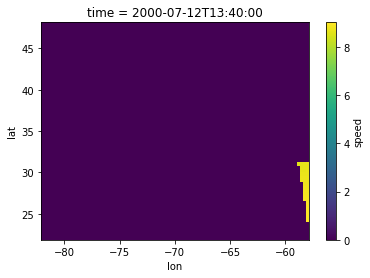

In [8]:
# Grab a single moment in time from this dataset 
# and plot the wind speed 

ds0 = ds.isel(time=20)
print(ds0)
fig, ax = plt.subplots() #subplot_kw = {'projection':ccrs.Mercator()}
# img_extent = [-88, -50, 8, 45]
# ax.set_extent(img_extent)
ds0.speed.plot(ax=ax,add_colorbar=True)
# ax.coastlines()

In [10]:
# Create an animation of all the speed time steps in the dataset
figs = []
for speed in ds.speed:
    fig, ax = plt.subplots(subplot_kw={'projection':ccrs.Mercator()})
    speed.plot(ax=ax, transform=ccrs.PlateCarree(),add_colorbar=False)
    ax.coastlines()
    figs.append(fig)
    plt.close(fig)
anim = animation_tools.animate_figs(figs)
HTML(anim.to_jshtml())

/home/catherinej/.pyenv/versions/miniconda3-3.9-4.10.3/lib/python3.9/site-packages/cartopy/crs.py:825: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/home/catherinej/.pyenv/versions/miniconda3-3.9-4.10.3/lib/python3.9/site-packages/cartopy/crs.py:877: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/home/catherinej/.pyenv/versions/miniconda3-3.9-4.10.3/lib/python3.9/site-packages/cartopy/crs.py:944: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.


In [16]:
ds

<xarray.Dataset>
Dimensions:   (time: 865, lat: 105, lon: 97, x: 2)
Coordinates:
  * lat       (lat) float64 22.0 22.25 22.5 22.75 23.0 ... 47.25 47.5 47.75 48.0
  * lon       (lon) float64 -82.0 -81.75 -81.5 -81.25 ... -58.5 -58.25 -58.0
  * time      (time) datetime64[ns] 2000-07-12T12:00:00 ... 2000-07-15T12:00:00
Dimensions without coordinates: x
Data variables:
    u         (time, lat, lon) float64 0.0 0.0 0.0 0.0 ... -2.512 -2.525 -2.537
    v         (time, lat, lon) float64 0.0 0.0 0.0 0.0 ... 9.389 9.305 9.222
    speed     (time, lat, lon) float64 0.0 0.0 0.0 0.0 ... 9.719 9.642 9.564
    pressure  (time, lat, lon) float64 1.013e+03 1.013e+03 ... 1.008e+03
    eye_loc   (time, x) float64 -82.0 22.0 -82.0 22.0 ... -58.0 48.0 -58.0 36.5

### Interpolation
For each patch created by geoclaw we're provided a resolution dx/dy, the initial points xlower, ylower, the number of points to create a location based array mx/my. 
In order to approximate the data at a different resolution than original we need to find the nearest datapoint in the existing arrays, and use bilinear interpolation to get the new values

In [32]:
# Get the nearest location of the datapoint we're trying to fill in
# If the corners of the box we're drawing are outside the original boundaries of the domain
# Use the value at the boundaries
def find_near(ds, near_lon, near_lat):
    if near_lon < min(ds.lon):
        near_lon = ds.lon[0]
    if near_lat < min(ds.lat): 
        near_lat = ds.lat[0]
    if near_lon > max(ds.lon): 
        near_lon = ds.lon[-1]
    if near_lat > max(ds.lat):
        near_lat = ds.lat[-1]
    # Find the nearest value to near_lat and near_lon by finding the minimum absolute distance   
    abslat = np.abs(ds.lat - near_lat)
    abslon = np.abs(ds.lon - near_lon)
    c = np.maximum(abslon, abslat)
    x, y = np.where(c == np.min(c))
    pts = ds.isel(lon=x[0], lat=y[0])
    return pts.lon.values, pts.lat.values


# Get the points for the patch, the 4 corners of the patch are llon (lower lon) ulon (upper lon) llat, ulat 
def get_interp_points(ds, lons, lats, llon, llat, ulon, ulat):
    points = [(llon, llat, ds.where((ds.lon == llon) &
                                    (ds.lat == llat), drop=True).values),
              (llon, ulat, ds.where((ds.lon == llon) &
                                    (ds.lat == ulat), drop=True).values),
              (ulon, llat, ds.where((ds.lon == ulon) &
                                    (ds.lat == llat), drop=True).values),
              (ulon, ulat, ds.where((ds.lon == ulon) &
                                    (ds.lat == ulat), drop=True).values)]
    return points



def bilinear_interpolation(ds, location, corners):
    """
     Interpolate location (lon, lat) from values associated with 4 points (corners).
     the four points are a list of four triplets (x, y, values)
     the four points can be in any order, they should form a rectangle
     """

    corners = sorted(corners)  # order points by x then by y
    (x1, y1, q11), (_x1, y2, q12), (x2, _y1, q21), (_x2, _y2, q22) = corners

    if x1 != _x1 or x2 != _x2 or y1 != _y1 or y2 != _y2:
        raise ValueError('points do not form a rectangle')
    if not x1 <= location[0] <= x2 or not y1 <= location[1] <= y2:
        raise ValueError('(x,y) not within rectangle')

    return (q11 * (x2 - location[0]) * (y2 - location[1]) +
            q21 * (location[0] - x1) * (y2 - location[1]) +
            q12 * (x2 - location[0]) * (location[1] - y1) +
            q22 * (location[0] - x1) * (location[1] - y1)) / ((x2 - x1) * (y2 - y1) + 0.00)

In [28]:
# Function to fill in each patch given by xlower, ylower, dx, dy, mx, my
# ds needs to be provided in function call to be speed or pressure or whichever values we're
# filling in

def fill_patches(ds, xlower, ylower, dx, dy, mx, my):
    patch_lons = [xlower + (i - 0.5) * dx for i in range(mx)]
    patch_lats = [ylower + (i - 0.5) * dy for i in range(my)]
    patch = np.empty(shape=(len(patch_lons), len(patch_lats)))
    for row_idx, lat in enumerate(patch_lats):
        for col_idx, lon in enumerate(patch_lons):
            # Find the corners of the box we're interpolating in by ensuring the corners are 
            # not the same as the points we're requesting
            llon, llat = find_near(ds, lon - .25, lat - .25)
            ulon, ulat = find_near(ds, lon + .25, lat + .25) 
            points = get_interp_points(ds, patch_lons, patch_lats, llon, llat, ulon, ulat)
            patch[row_idx, col_idx] = bilinear_interpolation(ds, [lon, lat], points)
    return patch, patch_lons, patch_lats

In [19]:
# Take a single point in time for now
dst = ds.isel(time=15)

# Create a random patch subset of the original 
xlower = np.random.choice(dst.lon)
ylower = np.random.choice(dst.lat)
dx = 0.35
dy = 0.35
mx = 20
my = 25

patch_lons = [xlower + i * dx for i in range(mx)]
patch_lats = [ylower + i * dy for i in range(my)]

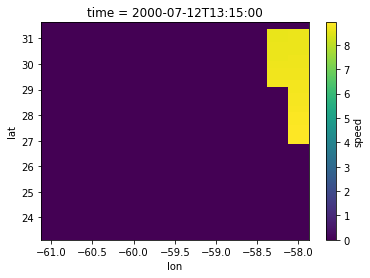

In [20]:
# Create a smaller copy of the original data with just the patch dimensions so we can see what
# we're looking at
t1 = dst.speed.where((dst.lat >= patch_lats[0]) & 
                     (dst.lat <= patch_lats[-1]) & 
                     (dst.lon >= patch_lons[0]) & 
                     (dst.lon <= patch_lons[-1]), drop=True)
t1.plot()

In [33]:
# Using bilinear interpolation find the speed values for the random patch at its new resolution

### add the dst.speed or .pressure or whatever at this step not in the loop above

new_patch, lons, lats = fill_patches(dst.speed, xlower, ylower, dx, dy, mx, my)

# Create a slice of the dataset with the patch data for comparison
orig_patch = dst.speed.where((dst.lat >= lats[0]) & 
                     (dst.lat <= lats[-1]) & 
                     (dst.lon >= lons[0]) & 
                     (dst.lon <= lons[-1]), drop=True)



ValueError: points do not form a rectangle

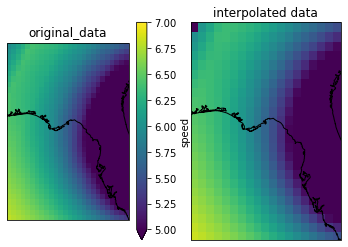

In [125]:
# Plot original and patch side by side as a comparison
fig, axs = plt.subplots(ncols=2, subplot_kw={'projection': ccrs.Mercator()})

Y, X = np.meshgrid(lats, lons)
orig_patch.plot(ax=axs[0], vmin=5, vmax=7, transform=ccrs.PlateCarree(), add_colorbar=False)
axs[0].set_title('original_data')
axs[0].coastlines()
im = axs[1].pcolormesh(X, Y, new_patch, vmin=5, vmax=7, transform=ccrs.PlateCarree())
axs[1].set_title('interpolated data')
axs[1].coastlines()
cax, kw = mpl.colorbar.make_axes([ax for ax in axes.flat])
plt.colorbar(im, cax=cax, **kw)
plt.show()

In [124]:
import matplotlib as mpl

In [113]:
new_patch.shape

(20, 25)

In [107]:
orig_patch

<xarray.DataArray 'speed' (lat: 33, lon: 26)>
array([[6.80533633, 6.77285672, 6.73910217, 6.70448937, 6.66829546,
        6.63055607, 6.59039902, 6.54799912, 6.5037057 , 6.45636323,
        6.40083933, 6.34229208, 6.28201521, 6.21778425, 6.15123049,
        6.08096264, 6.00671351, 5.93448936, 5.86524709, 5.79328135,
        5.71873494, 5.63063038, 5.52387063, 5.44851947, 5.38491315,
        5.32599665],
       [6.78001816, 6.74687057, 6.71226532, 6.67607427, 6.63849366,
        6.59927191, 6.55809231, 6.51099324, 6.45880548, 6.40334354,
        6.34468586, 6.28275367, 6.21790054, 6.15113755, 6.08070378,
        6.00620965, 5.92795159, 5.84570998, 5.77133978, 5.67901451,
        5.57624644, 5.46740165, 5.35260737, 5.24516704, 5.17934448,
        5.11934685],
       [6.75447566, 6.72318291, 6.68706369, 6.64948256, 6.6104163 ,
        6.56600118, 6.51938468, 6.46801411, 6.41265326, 6.35420546,
        6.29236987, 6.22713081, 6.15999424, 6.08935731, 6.01465657,
        5.93608314, 5.85355323, 5.74981656, 5.64326021, 5.53890775,
        5.42783721, 5.31041756, 5.18715795, 5.06047499, 4.97495566,
        4.91536252],
       [6.73058847, 6.7003177 , 6.66256732, 6.62058265, 6.57639715,
        6.52988493, 6.48094872, 6.42879417, 6.37044271, 6.30881041,
...
        5.47047833, 5.40956567, 5.29349619, 5.18686349, 5.09889495,
        5.03508192],
       [6.05570679, 6.15048894, 6.2488643 , 6.35160019, 6.38665372,
        6.35823003, 6.32990828, 6.30194967, 6.27411139, 6.24676314,
        6.20239603, 6.1445618 , 6.08856462, 6.03426191, 5.98211594,
        5.93200324, 5.86642148, 5.78144833, 5.70170369, 5.62909245,
        5.56376052, 5.50513043, 5.43272177, 5.33403435, 5.25763447,
        5.20085886],
       [6.00540128, 6.10032406, 6.19794792, 6.30051841, 6.40609339,
        6.37859806, 6.35022067, 6.32214138, 6.29796415, 6.27504166,
        6.25299494, 6.19745436, 6.14270858, 6.08979165, 6.03886629,
        5.99010868, 5.94369339, 5.86652758, 5.78912491, 5.71754817,
        5.65280052, 5.60381065, 5.56269767, 5.48776156, 5.41423552,
        5.35926738],
       [5.95429339, 6.0491605 , 6.14695945, 6.24834212, 6.35419649,
        6.40111189, 6.37631856, 6.35216737, 6.32890702, 6.30639002,
        6.28466865, 6.24992946, 6.19538753, 6.14371183, 6.09396252,
        6.04651075, 6.00143205, 5.94810574, 5.87565025, 5.81306557,
        5.75763538, 5.70968077, 5.66928473, 5.63040998, 5.56015369,
        5.50735061]])
Coordinates:
  * lat      (lat) float64 25.5 25.75 26.0 26.25 26.5 ... 32.75 33.0 33.25 33.5
  * lon      (lon) float64 -87.5 -87.25 -87.0 -86.75 ... -81.75 -81.5 -81.25
    time     datetime64[ns] 1938-09-21